In [246]:
%%capture
! pip3 install intake
! pip3 install xarray
! pip3 install aiohttp
! pip3 install hvplot
! pip3 install geopandas
! pip3 install geoplot
! pip3 install earthpy

In [69]:
import math

x, y= 456456.23, 1279721.064
m, n= 576628.34, 1071740.33

x_dist = x - m
y_dist = y - n

dist_sq = x_dist**2 + y_dist**2
distance = math.sqrt(dist_sq)
print(distance)

240202.668047278


In [70]:
import math
x1 = -90.21
y1 = 32.31
x2 = -88.95
y2 = 30.43
x_dist = math.radians(x1 - x2)
y_dist = math.radians(y1 - y2)
dist_sq = x_dist**2 + y_dist**2
dist_rad = math.sqrt(dist_sq)
dist_rad * 6371251.46

251664.4668769659

In [71]:
import math
x1 = -90.212452861859035
y1 = 32.316272202663704
x2 = -88.952170968942525
y2 = 30.438559624660321
x_dist = math.radians(x1 - x2)
y_dist = math.radians(y1 - y2)
y1_rad = math.radians(y1)
y2_rad = math.radians(y2)
a = math.sin(y_dist/2)**2 + math.sin(x_dist/2)**2 \
 * math.cos(y1_rad) * math.cos(y2_rad)
c = 2 * math.asin(math.sqrt(a))
distance = c * 6371 # kilometers
print(distance)

240.6359762909508


In [73]:
import geopandas as gpd

# Read file from Shapefile
fp = "../IND_adm.zip"
data = gpd.read_file(fp)

# Write to Shapefile (just make a copy)
#outfp = "temp/finland_municipalities.shp"
#data.to_file(outfp)

<AxesSubplot:>

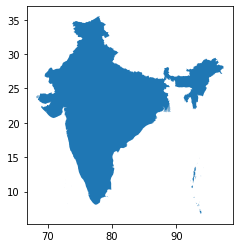

In [76]:
data.plot()

In [77]:
data.at[0, "geometry"]

In [78]:
print("Area:", round(data.at[0, "geometry"].area, 0), "square meters")


Area: 279.0 square meters


## Coordinate reference system (CRS) in Geopandas


Luckily, defining and changing projections is easy using Geopandas and a library called pyproj. In this tutorial we will see how to retrieve the coordinate reference system information from the data, and how to re-project the data into another crs. We will re-project a data file from WGS84 (lat, lon coordinates) into a Lambert Azimuthal Equal Area projection which is the recommended projection for Europe by European Commission.

For this tutorial we will be using a Shapefile called Europe_borders.shp representing the country borders in Europe, that you already should have downloaded during the previous tutorial into L2_data folder.

In Shapefiles, information about the coordinate reference system is stored in the .prj -file. If this file is missing, you might be in trouble!. When reading the data into GeoDataFrame with Geopandas crs information is automatically stored into the .crs attribute of the GeoDataFrame.

Let’s start by reading the data from the Europe_borders.shp file and checking the crs:

In [88]:
import geopandas as gpd

fp = "Data/Europe_borders.shp"
data = gpd.read_file(fp)
data.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [89]:
data.columns.values

array(['TZID', 'geometry'], dtype=object)

In [90]:
data["geometry"].head()

0    POLYGON ((8.45778 54.56236, 8.44953 54.56269, ...
1    POLYGON ((8.71992 47.69664, 8.72092 47.69530, ...
2    POLYGON ((6.73317 53.57409, 6.73017 53.57542, ...
3    POLYGON ((6.85822 53.59411, 6.85592 53.59550, ...
4    POLYGON ((6.89894 53.62561, 6.88439 53.62814, ...
Name: geometry, dtype: geometry

In [92]:
# Let's make a backup copy of our data
data_wgs84 = data.copy()

# Reproject the data
data = data.to_crs(epsg=3035)
data['geometry'].head()

0    POLYGON ((4221214.558 3496203.404, 4220681.651...
1    POLYGON ((4224860.478 2732279.320, 4224932.819...
2    POLYGON ((4104652.176 3390034.953, 4104460.401...
3    POLYGON ((4113025.664 3391895.756, 4112879.943...
4    POLYGON ((4115871.228 3395282.099, 4114921.348...
Name: geometry, dtype: geometry

To really understand what is going on, it is good to explore our data visually. Let’s compare the datasets by making maps out of them.

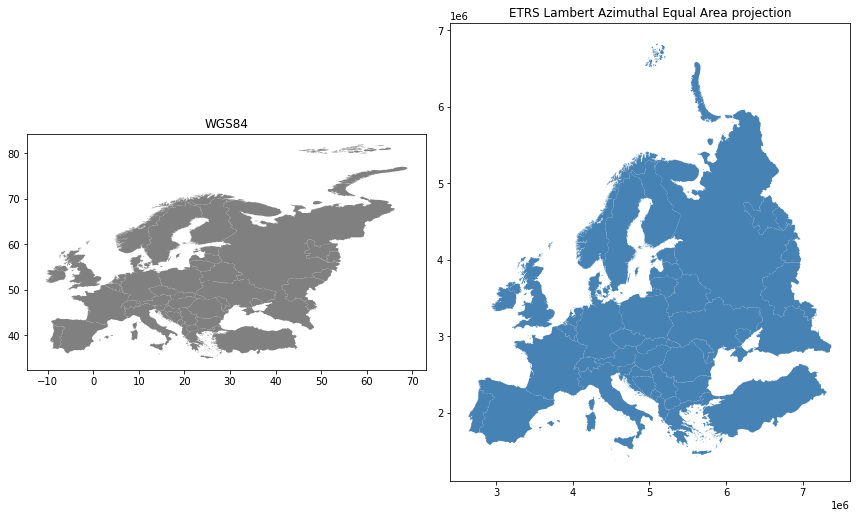

In [96]:
import matplotlib.pyplot as plt

fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(12, 12))

data_wgs84.plot(ax=ax1, facecolor='gray')
ax1.set_title("WGS84")
data.plot(ax=ax2, facecolor='steelblue')
ax2.set_title("ETRS Lambert Azimuthal Equal Area projection")
ax1.set_aspect(aspect=1)
ax2.set_aspect(aspect=1)
plt.tight_layout()

Indeed, the maps look quite different, and the re-projected one looks much better in Europe as the areas especially in the north are more realistic and not so stretched as in WGS84.

Finally, let’s save our projected layer into a Shapefile so that we can use it later. Note, even if the crs information is stored in the .prj file, it might be a good idea also to include crs info in the filename:

In [100]:
from pyproj import CRS
crs_dict = data_wgs84.crs

crs_object = CRS(data_wgs84.crs)

# EPSG code (here, the input crs information is a bit vague so we need to lower the confidence threshold)
crs_epsg = CRS(data_wgs84.crs).to_epsg(min_confidence=25)

# PROJ string
crs_proj4 = CRS(data_wgs84.crs).to_proj4()

# Well-Known Text (WKT)
crs_wkt = CRS(data_wgs84.crs).to_wkt()


In [101]:
print("PROJ dictionary:\n", crs_dict)
print("\nCRS object:\n", crs_object)
print("\nEPSG code: \n", crs_epsg)
print("\nPROJ string: \n", crs_proj4)
print("\nWell-Known Text (WKT):\n",crs_wkt)

PROJ dictionary:
 epsg:4326

CRS object:
 GEOGCRS["WGS 84",ENSEMBLE["World Geodetic System 1984 ensemble",MEMBER["World Geodetic System 1984 (Transit)"],MEMBER["World Geodetic System 1984 (G730)"],MEMBER["World Geodetic System 1984 (G873)"],MEMBER["World Geodetic System 1984 (G1150)"],MEMBER["World Geodetic System 1984 (G1674)"],MEMBER["World Geodetic System 1984 (G1762)"],ELLIPSOID["WGS 84",6378137,298.257223563,LENGTHUNIT["metre",1]],ENSEMBLEACCURACY[2.0]],PRIMEM["Greenwich",0,ANGLEUNIT["degree",0.0174532925199433]],CS[ellipsoidal,2],AXIS["geodetic latitude (Lat)",north,ORDER[1],ANGLEUNIT["degree",0.0174532925199433]],AXIS["geodetic longitude (Lon)",east,ORDER[2],ANGLEUNIT["degree",0.0174532925199433]],USAGE[SCOPE["Horizontal component of 3D system."],AREA["World."],BBOX[-90,-180,90,180]],ID["EPSG",4326]]

EPSG code: 
 4326

PROJ string: 
 +proj=longlat +datum=WGS84 +no_defs +type=crs

Well-Known Text (WKT):
 GEOGCRS["WGS 84",ENSEMBLE["World Geodetic System 1984 ensemble",MEMBER["Wor

In [105]:
path = "Data/ne_110m_admin_0_countries/ne_110m_admin_0_countries.shp" 
admin = gpd.read_file(path)
admin.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

Text(0.5, 1.0, 'WGS84')

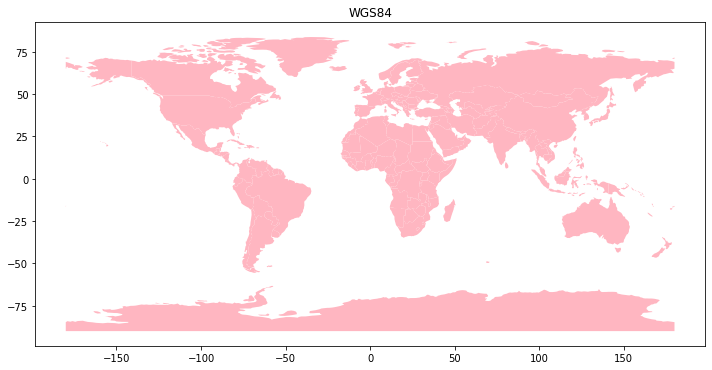

In [109]:
plt.rcParams['figure.figsize'] = [12, 6]
admin.plot(color= "lightpink")
plt.title("WGS84")

Text(0.5, 1.0, 'Eckert IV')

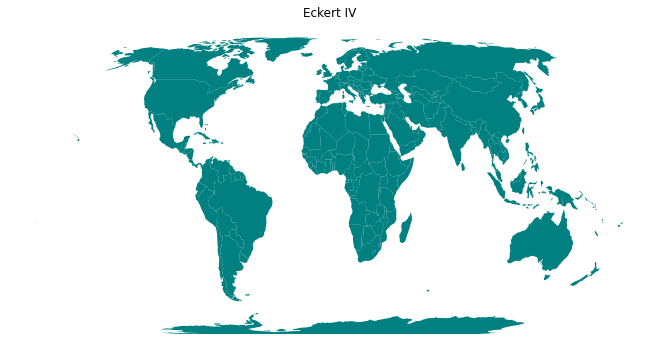

In [119]:
# Define projection Eckert IV from https://spatialreference.org/ref/esri/54012/
ECKERT_IV= "+proj=eck4 +lon_0=0 +x_0=0 +y_0=0 +ellps=WGS84 +datum=WGS84 +units=m +no_defs"
eckert_IV = CRS.from_proj4(ECKERT_IV)
admin.to_crs(eckert_IV).plot(color= "teal")

plt.axis('off')
plt.title("Eckert IV")

Text(0.5, 1.0, 'Orthographic')

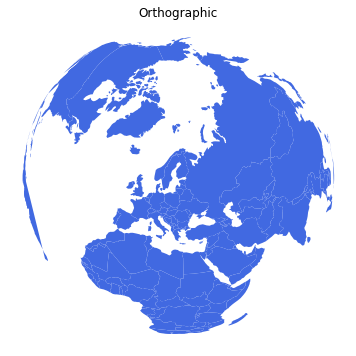

In [123]:
# Define an orthographic projection, centered in Finland! 
# from: http://www.statsmapsnpix.com/2019/09/globe-projections-and-insets-in-qgis.html
ORTHO= "+proj=ortho +lat_0=60.00 +lon_0=23.0000 +x_0=0 +y_0=0 +a=6370997 +b=6370997 +units=m +no_defs"
ortho = CRS.from_proj4(ORTHO)
admin.to_crs(ortho).plot(color= "royalblue")

plt.axis('off')
plt.title("Orthographic")

## Geocoding

In [127]:
from pandas import read_csv
from shapely.geometry import Point

path = r"addresses.txt"
data = read_csv(path, sep=';')
data.head()

,id,Address
0,1000,"Carrer de Mallorca, 401, 08013 Barcelona, Spain"
1,1001,"Carrer dels Almogàvers, 119, 08018 Barcelona, ..."
2,1002,"Gran Via de les Corts Catalanes, 585, 08007 Ba..."


In [129]:
from geopandas.tools import geocode

geo = geocode(data['Address'], provider='nominatim', user_agent='autogis_xx', timeout=4)
geo.head()

,geometry,address
0,POINT (2.17441 41.40348),"Basílica de la Sagrada Família, 401, Carrer de..."
1,POINT (2.18988 41.39710),"119-123, Carrer dels Almogàvers, el Parc i la ..."
2,POINT (2.16383 41.38670),Edifici Històric de la Universitat de Barcelon...


In [131]:
join= geo.join(data)
join.head()

,geometry,address,id,Address
0,POINT (2.17441 41.40348),"Basílica de la Sagrada Família, 401, Carrer de...",1000,"Carrer de Mallorca, 401, 08013 Barcelona, Spain"
1,POINT (2.18988 41.39710),"119-123, Carrer dels Almogàvers, el Parc i la ...",1001,"Carrer dels Almogàvers, 119, 08018 Barcelona, ..."
2,POINT (2.16383 41.38670),Edifici Històric de la Universitat de Barcelon...,1002,"Gran Via de les Corts Catalanes, 585, 08007 Ba..."


In [133]:
out_path = "Shapfiles/addresses.shp"
join.to_file(out_path)

## Point in Polygon and Intersect
Finding out if a certain point is located inside or outside of an area, or finding out if a line intersects with another line or polygon are fundamental geospatial operations that are often used e.g. to select data based on location. Such spatial queries are one of the typical first steps of the workflow when doing spatial analysis. Performing a spatial join (will be introduced later) between two spatial datasets is one of the most typical applications where Point in Polygon (PIP) query is used.

How to check if point is inside a polygon?¶
Computationally, detecting if a point is inside a polygon is most commonly done using a specific formula called Ray Casting algorithm. Luckily, we do not need to create such a function ourselves for conducting the Point in Polygon (PIP) query. Instead, we can take advantage of Shapely’s binary predicates that can evaluate the topolocical relationships between geographical objects, such as the PIP as we’re interested here.

There are basically two ways of conducting PIP in Shapely:

using a function called within() that checks if a point is within a polygon

using a function called contains() that checks if a polygon contains a point

Notice: even though we are talking here about Point in Polygon operation, it is also possible to check if a LineString or Polygon is inside another Polygon.

Let’s import shapely functionalities and create some points:

In [138]:
from shapely.geometry import Point, Polygon

Point_1 = Point(24.952242, 60.1696017)
Point_2 = Point(24.976567, 60.1612500)
coords = [(24.950899, 60.169158), (24.953492, 60.169158), (24.953510, 60.170104), (24.950958, 60.169990)]
poly = Polygon(coords)

In [137]:
print(poly)

POLYGON ((24.950899 60.169158, 24.953492 60.169158, 24.95351 60.170104, 24.950958 60.16999, 24.950899 60.169158))


In [140]:
print(Point_1.within(poly), Point_2.within(poly))

True False


In [142]:
poly.contains(Point_1), poly.contains(Point_2)

(True, False)

Let's check **intersect** feature:

 Another typical geospatial operation is to see if a geometry intersects or touches another one. Again, there are binary operations in Shapely for checking these spatial relationships:

intersects(): Two objects intersect if the boundary or interior of one object intersect in any way with the boundary or interior of the other object.

touches(): Two objects touch if the objects have at least one point in common and their interiors do not intersect with any part of the other object.

Let’s try these out.

Let’s create two LineStrings:

In [144]:
from shapely.geometry import LineString, MultiLineString

line_a = LineString([(0, 0), (1, 1)])
line_b = LineString([(1, 1), (0, 2)])
line_a.intersects(line_b), line_a.touches(line_b)

(True, True)

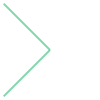

In [145]:
multi_line = MultiLineString([line_a, line_b])
multi_line

In [146]:
line_a.touches(line_a), line_a.intersects(line_a)


(False, True)

## Spatial Joins
Getting attributes from one layer and transferring them into another layer based on their spatial relationship is something you most likely need to do on a regular basis.

In [154]:
import geopandas as gpd
from pyproj import CRS
import requests
import geojson

# Specify the url for web feature service
url = 'https://kartta.hsy.fi/geoserver/wfs'

# Specify parameters (read data in json format). 
# Available feature types in this particular data source: 
# http://geo.stat.fi/geoserver/vaestoruutu/wfs?service=wfs&version=2.0.0&request=describeFeatureType
params = dict(service='WFS', 
              version='2.0.0', 
              request='GetFeature', 
              typeName='asuminen_ja_maankaytto:Vaestotietoruudukko_2018', 
              outputFormat='json')

# Fetch data from WFS using requests
r = requests.get(url, params=params)

# Create GeoDataFrame from geojson
pop = gpd.GeoDataFrame.from_features(geojson.loads(r.content))

In [155]:
pop.head()

,geometry,index,asukkaita,asvaljyys,ika0_9,ika10_19,ika20_29,ika30_39,ika40_49,ika50_59,ika60_69,ika70_79,ika_yli80
0,MULTIPOLYGON Z (((25476499.999 6674248.999 0.0...,3342,108,45,11,23,6,7,26,17,8,6,4
1,MULTIPOLYGON Z (((25476749.997 6674498.998 0.0...,3503,273,35,35,24,52,62,40,26,25,9,0
2,MULTIPOLYGON Z (((25476999.994 6675749.004 0.0...,3660,239,34,46,24,24,45,33,30,25,10,2
3,MULTIPOLYGON Z (((25476999.994 6675499.004 0.0...,3661,202,30,52,37,13,36,43,11,4,3,3
4,MULTIPOLYGON Z (((25476999.994 6675249.005 0.0...,3662,261,30,64,32,36,64,34,20,6,3,2


In [156]:
pop = pop.rename(columns={'asukkaita': 'pop18'})

# Check the column names
pop.columns

Index(['geometry', 'index', 'pop18', 'asvaljyys', 'ika0_9', 'ika10_19',
       'ika20_29', 'ika30_39', 'ika40_49', 'ika50_59', 'ika60_69', 'ika70_79',
       'ika_yli80'],
      dtype='object')

In [157]:
pop = pop[["pop18", "geometry"]]
pop.head()

,pop18,geometry
0,108,MULTIPOLYGON Z (((25476499.999 6674248.999 0.0...
1,273,MULTIPOLYGON Z (((25476749.997 6674498.998 0.0...
2,239,MULTIPOLYGON Z (((25476999.994 6675749.004 0.0...
3,202,MULTIPOLYGON Z (((25476999.994 6675499.004 0.0...
4,261,MULTIPOLYGON Z (((25476999.994 6675249.005 0.0...


In [160]:
path = r"finnish_addresses.txt"
data = read_csv(path, sep=';')
geo = geocode(data['addr'], provider='nominatim', user_agent='autogis_xx', timeout=4)
join= geo.join(data)
out_path = "Shapfiles/finnish_addresses.shp"
join.to_file(out_path)

In [162]:
addr_fp = r"Shapfiles/finnish_addresses.shp"
addresses = gpd.read_file(addr_fp)
addresses.head()

,address,id,addr,geometry
0,"Ruoholahti, 14, Itämerenkatu, Ruoholahti, Läns...",1000,"Itämerenkatu 14, 00101 Helsinki, Finland",POINT (24.91556 60.16320)
1,"Kamppi, 1, Kampinkuja, Kamppi, Eteläinen suurp...",1001,"Kampinkuja 1, 00100 Helsinki, Finland",POINT (24.93169 60.16902)
2,"Kauppakeskus Citycenter, 8, Kaivokatu, Keskust...",1002,"Kaivokatu 8, 00101 Helsinki, Finland",POINT (24.94179 60.16989)
3,"Hermannin rantatie, Hermanninmäki, Hermanni, K...",1003,"Hermannin rantatie 1, 00580 Helsinki, Finland",POINT (24.97759 60.19361)


In [166]:
addresses.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [168]:
pop.crs

In [169]:
pop.crs = CRS.from_epsg(3879).to_wkt()
pop.crs

<Projected CRS: EPSG:3879>
Name: ETRS89 / GK25FIN
Axis Info [cartesian]:
- N[north]: Northing (metre)
- E[east]: Easting (metre)
Area of Use:
- name: Finland - nominally onshore between 24°30'E and 25°30'E but may be used in adjacent areas if a municipality chooses to use one zone over its whole extent.
- bounds: (24.5, 59.94, 25.5, 68.9)
Coordinate Operation:
- name: Finland Gauss-Kruger zone 25
- method: Transverse Mercator
Datum: European Terrestrial Reference System 1989 ensemble
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [171]:
addresses = addresses.to_crs(pop.crs)
addresses.crs == pop.crs

True

In [ ]:
join = gpd.sjoin(addresses, pop, how="inner", op="within")
join.head()

<AxesSubplot:>

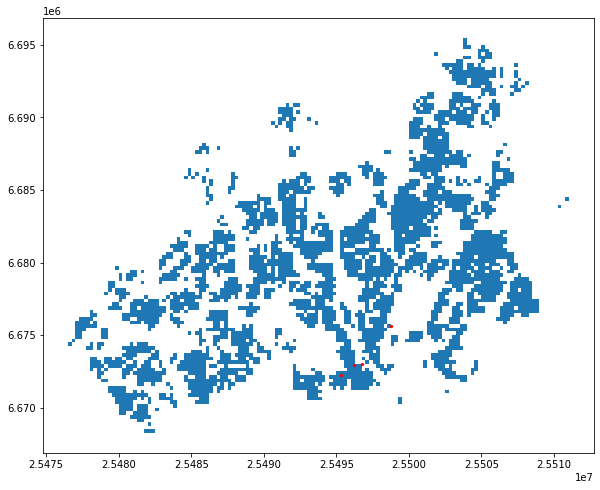

In [178]:
import matplotlib.pyplot as plt

# Create a figure with one subplot
fig, ax = plt.subplots(figsize=(15,8))

# Plot population grid
pop.plot(ax=ax)

# Plot points
addresses.plot(ax=ax, color='red', markersize=5)

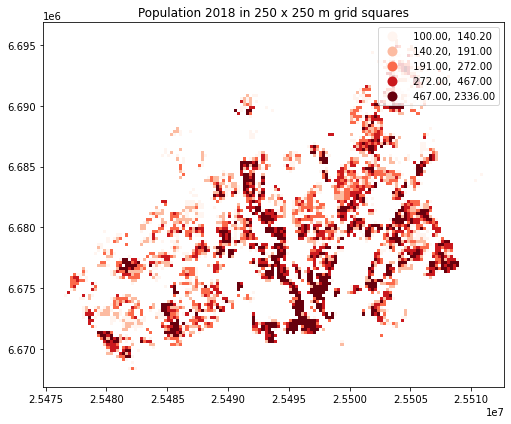

In [184]:
fig, ax = plt.subplots(figsize=(10,6))

# Plot the grid with population info
pop.plot(ax=ax, column='pop18', cmap="Reds", scheme='quantiles', legend=True);

# Add title
plt.title("Population 2018 in 250 x 250 m grid squares");

# Remove white space around the figure
plt.tight_layout()

In [ ]:
fig, ax = plt.subplots(figsize=(10,6))

# Plot the points with population info
join.plot(ax=ax, column='pop18', cmap="Reds", markersize=15, scheme='quantiles', legend=True);

# Add title
plt.title("Amount of inhabitants living close the the point");

# Remove white space around the figure
plt.tight_layout()

## Overlay Analysis

In [203]:
import geopandas as gpd
import matplotlib.pyplot as plt
import shapely.speedups
%matplotlib inline

# File paths
border_fp = "Helsinki_borders.shp"
grid_fp = "TravelTimes_to_5975375_RailwayStation.shp"

# Read files
grid = gpd.read_file(grid_fp)
hel = gpd.read_file(border_fp)

<AxesSubplot:>

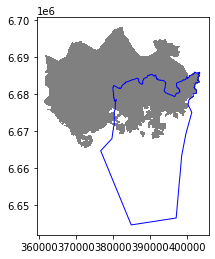

In [204]:
ax = grid.plot(facecolor='gray')
hel.plot(ax=ax, facecolor='None', edgecolor='blue')

In [207]:
hel.crs == grid.crs

True

In [ ]:
intersection = gpd.overlay(grid, hel, how='intersection')
intersection.plot(color="royalblue")

In [ ]:
intersection.head()


In [ ]:
outfp = "TravelTimes_to_5975375_RailwayStation_Helsinki.geojson"
intersection.to_file(outfp, driver="GeoJSON")

In [ ]:
dissolved = intersection.dissolve(by="car_r_t")
dissolved.head()

In [ ]:
print('Rows in original intersection GeoDataFrame:', len(intersection))
print('Rows in dissolved layer:', len(dissolved))

PROJCS["Mercator_2SP",GEOGCS["GCS_GRS 1980(IUGG, 1980)",DATUM["D_unknown",SPHEROID["GRS80",6378137,298.257222101]],PRIMEM["Unknown",0],UNIT["Degree",0.0174532925199433]],PROJECTION["Mercator_2SP"],PARAMETER["standard_parallel_1",-2],PARAMETER["central_meridian",-43],PARAMETER["false_easting",5000000],PARAMETER["false_northing",10000000],UNIT["metre",1,AUTHORITY["EPSG","9001"]],AXIS["Easting",EAST],AXIS["Northing",NORTH]]


<AxesSubplot:>

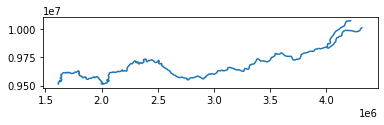

In [209]:
import geopandas as gpd

fp = "Amazon_river.shp"
data = gpd.read_file(fp)

# Print crs
print(data.crs)

# Plot the river
data.plot()

In [210]:
data.head()

,bbox_east,bbox_north,bbox_south,bbox_west,place_name,geometry
0,-49.10927,0.70653,-4.44219,-73.450126,"Rio Amazonas, Microrregião de Manaus, Mesorreg...","MULTILINESTRING ((1612358.589 9508606.173, 161..."


<AxesSubplot:>

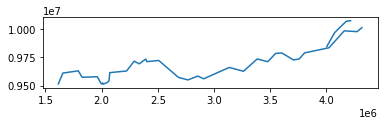

In [211]:
# Generalize geometry
data['geom_gen'] = data.simplify(tolerance=20000)

# Set geometry to be our new simlified geometry
data = data.set_geometry('geom_gen')

# Plot 
data.plot()

In [212]:
import json
import numpy as np
import pandas as pd
import geopandas as gpd
from pyproj import CRS
import matplotlib.pyplot as plt

In [213]:
url = "http://geo.stat.fi/geoserver/tilastointialueet/wfs?request=GetFeature&typename=tilastointialueet:kunta1000k&outputformat=JSON"
geodata = gpd.read_file(url)
geodata.head()

,id,kunta,vuosi,nimi,namn,name,geometry
0,kunta1000k.1,005,2021,Alajärvi,Alajärvi,Alajärvi,"POLYGON ((366787.924 7001300.583, 364150.540 7..."
1,kunta1000k.2,009,2021,Alavieska,Alavieska,Alavieska,"POLYGON ((382543.364 7120022.976, 380556.177 7..."
2,kunta1000k.3,010,2021,Alavus,Alavo,Alavus,"POLYGON ((343298.204 6961570.195, 340572.015 6..."
3,kunta1000k.4,016,2021,Asikkala,Asikkala,Asikkala,"POLYGON ((436139.680 6798279.085, 432732.949 6..."
4,kunta1000k.5,018,2021,Askola,Askola,Askola,"POLYGON ((426631.036 6720528.076, 425751.505 6..."


In [214]:
#Select and rename columns
geodata.rename(columns={'kunta':'code'}, inplace=True)
geodata = geodata[['code','name', 'geometry']]
geodata.head()

,code,name,geometry
0,005,Alajärvi,"POLYGON ((366787.924 7001300.583, 364150.540 7..."
1,009,Alavieska,"POLYGON ((382543.364 7120022.976, 380556.177 7..."
2,010,Alavus,"POLYGON ((343298.204 6961570.195, 340572.015 6..."
3,016,Asikkala,"POLYGON ((436139.680 6798279.085, 432732.949 6..."
4,018,Askola,"POLYGON ((426631.036 6720528.076, 425751.505 6..."


<AxesSubplot:>

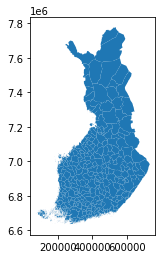

In [215]:
geodata.plot()


In [218]:
data = pd.read_excel(r"Shp_jäsenkunnat_2020.xls", sheet_name="kunnat_shp_2020_ aakkosjärj.", header=3)

In [219]:
data.head()


,kunta-\nkoodi,kunta,shp:n koodi,sairaanhoitopiiri,erva-alue,kuntien lkm
0,NaN,NaN,NaN,NaN,NaN,NaN
1,20.0,Akaa,6.0,Pirkanmaa,TAYS,1.0
2,5.0,Alajärvi,15.0,Etelä-Pohjanmaa,TAYS,2.0
3,9.0,Alavieska,18.0,Pohjois-Pohjanmaa,OYS,3.0
4,10.0,Alavus,15.0,Etelä-Pohjanmaa,TAYS,4.0


In [220]:
data.dropna(inplace=True)


In [221]:
data.rename(columns={"kunta-\nkoodi":"code", 'sairaanhoitopiiri':'healthCareDistrict'}, inplace=True)

# Select only useful columns
data = data[['code','healthCareDistrict']]
data.head()

,code,healthCareDistrict
1,20.0,Pirkanmaa
2,5.0,Etelä-Pohjanmaa
3,9.0,Pohjois-Pohjanmaa
4,10.0,Etelä-Pohjanmaa
5,16.0,Päijät-Häme


In [222]:
number = data.at[1, "code"]
number

20.0

In [223]:
"0" + str(int(number))

'020'

In [225]:
data["code"] = data["code"].astype(int).astype('str')

# Add missing zeros to municipality codes
data["code"] = data["code"].apply(lambda x: "00" + x if len(x)==1 else x)
data["code"] = data["code"].apply(lambda x: "0" + x if len(x)==2 else x)
data.head()


,code,healthCareDistrict
1,020,Pirkanmaa
2,005,Etelä-Pohjanmaa
3,009,Pohjois-Pohjanmaa
4,010,Etelä-Pohjanmaa
5,016,Päijät-Häme


In [227]:
# Merge health district info to geodata using "code" as the common key
geodata = geodata.merge(data, on="code", how="left")
geodata.head()

,code,name,geometry,healthCareDistrict_x,healthCareDistrict_y
0,005,Alajärvi,"POLYGON ((366787.924 7001300.583, 364150.540 7...",Etelä-Pohjanmaa,Etelä-Pohjanmaa
1,009,Alavieska,"POLYGON ((382543.364 7120022.976, 380556.177 7...",Pohjois-Pohjanmaa,Pohjois-Pohjanmaa
2,010,Alavus,"POLYGON ((343298.204 6961570.195, 340572.015 6...",Etelä-Pohjanmaa,Etelä-Pohjanmaa
3,016,Asikkala,"POLYGON ((436139.680 6798279.085, 432732.949 6...",Päijät-Häme,Päijät-Häme
4,018,Askola,"POLYGON ((426631.036 6720528.076, 425751.505 6...",HUS,HUS


In [234]:
geodata[geodata["healthCareDistrict_x"].isnull()].name

7          Brändö
8          Eckerö
15       Finström
17          Föglö
18           Geta
24     Hammarland
57         Jomala
111      Kumlinge
121         Kökar
134       Lemland
147    Lumparland
153     Mariehamn
236       Saltvik
254      Sottunga
256          Sund
301         Vårdö
Name: name, dtype: object

In [236]:
# Update "Ahvenanmaa" as the health care district for Åland municipalities (16 municipalities in total)
geodata.loc[geodata["healthCareDistrict_x"].isnull(), "healthCareDistrict_x"] = "Ahvenanmaa"

In [237]:
geodata["healthCareDistrict_x"].value_counts()


Pohjois-Pohjanmaa    29
Varsinais-Suomi      28
HUS                  24
Pirkanmaa            23
Keski-Suomi          21
Etelä-Pohjanmaa      18
Pohjois-Savo         18
Satakunta            16
Ahvenanmaa           16
Lappi                15
Pohjois-Karjala      13
Vaasa                13
Päijät-Häme          12
Kanta-Häme           11
Keski-Pohjanmaa      10
Etelä-Savo            9
Etelä-Karjala         9
Kainuu                8
Länsi-Pohja           6
Kymenlaakso           6
Itä-Savo              4
Name: healthCareDistrict_x, dtype: int64

In [239]:
# Dissolve (=combine) municipality polygon geometries for each health care district
districts = geodata.dissolve(by='healthCareDistrict_x')

In [240]:
districts.reset_index(inplace=True)
districts = districts[["healthCareDistrict_x", "geometry"]]
districts.head()

,healthCareDistrict_x,geometry
0,Ahvenanmaa,"MULTIPOLYGON (((160681.339 6644663.142, 160710..."
1,Etelä-Karjala,"POLYGON ((532977.917 6741313.207, 529917.560 6..."
2,Etelä-Pohjanmaa,"POLYGON ((222946.328 6887833.806, 220077.099 6..."
3,Etelä-Savo,"POLYGON ((520632.817 6786551.176, 520842.240 6..."
4,HUS,"MULTIPOLYGON (((272126.112 6633609.689, 272356..."


(40857.339215, 765862.479085, 6575077.820610001, 7833703.7515899995)

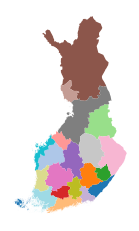

In [243]:
districts.plot(column='healthCareDistrict_x', scheme="equal_interval",cmap='tab20', k=20)
plt.axis('off')

In [244]:
# Write GeoJSON in original projection
districts.to_file("healthDistrictsEPSG3067.geojson", driver='GeoJSON', encoding='utf-8')
# Re-project to WGS84 and save again
wgs84 = CRS.from_epsg(4326)
districts.to_crs(wgs84).to_file("healthDistrictsEPSG4326.geojson", driver='GeoJSON', encoding='utf-8')

In [186]:
%%capture
! pip3 install folium

In [187]:
import folium
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt

In [189]:
base= "https://raw.githubusercontent.com/Automating-GIS-processes/"
main= "site/master/source/notebooks/L5/data/seutukunta_tyollisyys_2013.csv"
data = pd.read_csv(base+main, sep=",")
data.head()

,seutukunta,seutukunta_nimi,tyollisyys
0,SK011,Helsingin seutukunta,73.0
1,SK014,Raaseporin seutukunta,70.3
2,SK015,Porvoon seutukunta,74.3
3,SK016,Loviisan seutukunta,71.5
4,SK021,Åboland-Turunmaan seutukunta,72.9


In [190]:
# A layer saved to GeoJson in QGIS..
#geodata = gpd.read_file('Seutukunnat_2018.geojson')

# Get features directly from the wfs
url = "http://geo.stat.fi/geoserver/tilastointialueet/wfs?request=GetFeature&typename=tilastointialueet:seutukunta1000k_2018&outputformat=JSON"
geodata = gpd.read_file(url)

In [191]:
data["seutukunta"] = data["seutukunta"].apply(lambda x: x[2:])
data["seutukunta"].head()

0    011
1    014
2    015
3    016
4    021
Name: seutukunta, dtype: object

In [192]:
print("Count of original attributes:", len(data))
print("Count of original geometries:", len(geodata))

# Merge data
geodata = geodata.merge(data, on = "seutukunta")

#Print info
print("Count after the join:", len(geodata))

geodata.head()

Count of original attributes: 70
Count of original geometries: 70
Count after the join: 70


,id,vuosi,seutukunta,nimi,namn,name,geometry,seutukunta_nimi,tyollisyys
0,seutukunta1000k_2018.1,2018,011,Helsinki,Helsingfors,Helsinki,"MULTIPOLYGON (((409963.522 6681658.341, 409969...",Helsingin seutukunta,73.0
1,seutukunta1000k_2018.2,2018,014,Raasepori,Raseborg,Raasepori,"MULTIPOLYGON (((306616.919 6665438.489, 306668...",Raaseporin seutukunta,70.3
2,seutukunta1000k_2018.3,2018,015,Porvoo,Borgå,Porvoo,"MULTIPOLYGON (((427108.141 6694151.025, 427175...",Porvoon seutukunta,74.3
3,seutukunta1000k_2018.4,2018,016,Loviisa,Lovisa,Loviisa,"MULTIPOLYGON (((444038.768 6703649.355, 444155...",Loviisan seutukunta,71.5
4,seutukunta1000k_2018.5,2018,021,Åboland-Turunmaa,Åboland-Turunmaa,Åboland-Turunmaa,"MULTIPOLYGON (((190999.717 6715878.622, 191021...",Åboland-Turunmaan seutukunta,72.9


<AxesSubplot:>

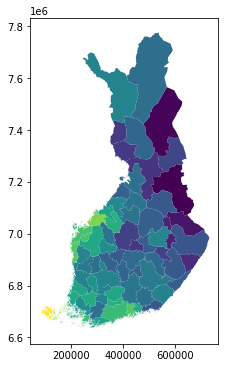

In [193]:
geodata.plot(column="tyollisyys")

<AxesSubplot:>

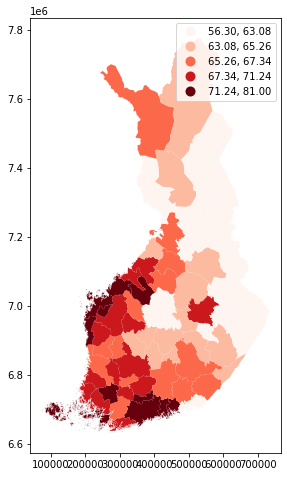

In [194]:
# Adjust figure size
fig, ax = plt.subplots(1, figsize=(10, 8))

# Adjust colors and add a legend
geodata.plot(ax=ax, column="tyollisyys", scheme="quantiles", cmap="Reds", legend=True)

In [195]:
geodata['geoid'] = geodata.index.astype(str)


In [196]:
# Create a Map instance
m = folium.Map(location=[60.25, 24.8], tiles = 'cartodbpositron', zoom_start=8, control_scale=True)

folium.Choropleth(geo_data = geodata, 
                  data = geodata, 
                  columns=['geoid','tyollisyys'], 
                  key_on='feature.id', 
                  fill_color='RdYlBu', 
                  line_color='white',
                  line_weight=0,
                  legend_name= 'Employment rate in Finland').add_to(m)
m


In [197]:
folium.features.GeoJson(geodata, name='Labels',
               style_function=lambda x: {'color':'transparent','fillColor':'transparent','weight':0},
                tooltip=folium.features.GeoJsonTooltip(fields=['tyollisyys'],
                                              aliases = ['Employment rate'],
                                              labels=True,
                                              sticky=False
                                             )
                       ).add_to(m)

m

In [198]:
import branca

# Create a series (or a dictionary?) out of the variable that you want to map
employed_series = data.set_index('seutukunta')['tyollisyys']

# Setl colorscale
colorscale = branca.colormap.linear.RdYlBu_05.to_step(data = geodata['tyollisyys'], n = 6, method = 'quantiles')

#Define style function
def my_color_function(feature):
    
   employed = employed_series.get(int(feature['id']), None)

   return {
       'fillOpacity': 0.5,
       'weight': 0,
       'fillColor': '#black' if employed is None else colorscale(employed)
       }


In [199]:
# Based on :
#https://python-visualization.github.io/folium/quickstart.html
#https://github.com/python-visualization/folium/blob/master/examples/Colormaps.ipynb


# Create a Map instance
m = folium.Map(location=[60.25, 24.8], tiles = 'cartodbpositron', zoom_start=6, control_scale=True)

# add geojson layer on the map, which visualizes the polygons based on your style function, and additional parameters  
folium.GeoJson(
   geodata,
   name = "Employment rate in Finland (2013)",
   style_function=my_color_function,
   tooltip=folium.features.GeoJsonTooltip(fields=['nimi','tyollisyys'],
                                             aliases = ['Region','Employment rate (%)'],
                                             labels=True,
                                             sticky=True)
).add_to(m)


#Add a legend
colorscale .caption = 'Employment rate (%)'
m.add_child(colorscale)

# Create a layer control object and add it to our map instance
folium.LayerControl().add_to(m)

#Show map
m

In [ ]:
! pip3 install rioxarray

In [249]:
# Import necessary packages
import os

import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
# Use geopandas for vector data and xarray for raster data
import geopandas as gpd
import rioxarray as rxr

import earthpy as et

# Prettier plotting with seaborn
sns.set(font_scale=1.5, style="white")

In [250]:
# Get data and set working directory
et.data.get_data("colorado-flood")
os.chdir(os.path.join(et.io.HOME,
                      'earth-analytics',
                      'data'))

Extracted output to /Users/ankitbit/earth-analytics/data/colorado-flood/.


In [251]:
# Define relative path to file
dem_pre_path = os.path.join("colorado-flood",
                            "spatial",
                            "boulder-leehill-rd",
                            "pre-flood",
                            "lidar",
                            "pre_DTM.tif")

dtm_pre_arr = rxr.open_rasterio(dem_pre_path)
dtm_pre_arr

<xarray.DataArray (band: 1, y: 2000, x: 4000)>
[8000000 values with dtype=float32]
Coordinates:
  * band         (band) int64 1
  * x            (x) float64 4.72e+05 4.72e+05 4.72e+05 ... 4.76e+05 4.76e+05
  * y            (y) float64 4.436e+06 4.436e+06 ... 4.434e+06 4.434e+06
    spatial_ref  int64 0
Attributes:
    _FillValue:    -3.4028234663852886e+38
    scale_factor:  1.0
    add_offset:    0.0

When you open raster data using xarray or rioxarray you are creating an xarray.DataArray. The. DataArray object stores the:

raster data in a numpy array format
spatial metadata including the CRS, spatial extent of the object
and any metadata
Xarray and numpy provide an efficient way to work with and process raster data. xarray also supports dask and parallel processing which allows you to more efficiently process larger datasets using the processing power that you have on your computer

When you add rioxarray to your package imports, you further get access to spatial data processing using xarray objects. Below, you can view the spatial extent (bounds()) and CRS of the data that you just opened above.

In [252]:
# View the Coordinate Reference System (CRS) & spatial extent
print("The CRS for this data is:", dtm_pre_arr.rio.crs)
print("The spatial extent is:", dtm_pre_arr.rio.bounds())

The CRS for this data is: EPSG:32613
The spatial extent is: (472000.0, 4434000.0, 476000.0, 4436000.0)


In [253]:
# View no data value
print("The no data value is:", dtm_pre_arr.rio.nodata)

The no data value is: -3.4028235e+38


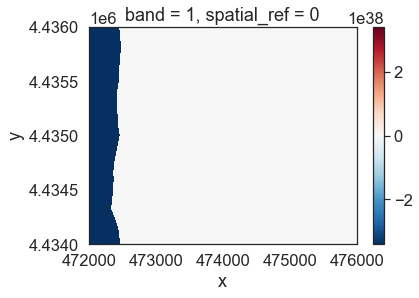

In [254]:
dtm_pre_arr.plot()
plt.show()

The data above should represent terrain model data. However, the range of values is not what is expected. These data are for Boulder, Colorado where the elevation may range from 1000-3000m. There may be some outlier values in the data that may need to be addressed. Below you look at the distribution of pixel values in the data by plotting a histogram.

Notice that there seem to be a lot of pixel values in the negative range in that plot.

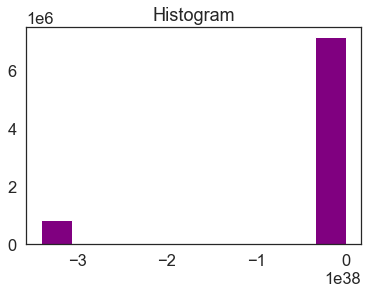

In [255]:
# A histogram can also be helpful to look at the range of values in your data
# What do you notice about the histogram below?
dtm_pre_arr.plot.hist(color="purple")
plt.show()

Histogram for your lidar DTM. Notice the number of values that are below 0. This suggests that there may be no data values in the data.
Looking at the min and max values of the data, you can see a very small negative number for the minimum. This number matches the nodata value that you looked at above.

In [256]:
print("the minimum raster value is: ", np.nanmin(dtm_pre_arr.values))
print("the maximum raster value is: ", np.nanmax(dtm_pre_arr.values))

the minimum raster value is:  -3.4028235e+38
the maximum raster value is:  2087.43


Raster Data Exploration - Min and Max Values
Looking at the minimum value of the data, there is one of two things going on that need to be fixed:

there may be no data values in the data with a negative value that are skewing your plot colors
there also could be outlier data in your raster
You can explore the first option - that there are no data values by reading in the data and masking no data values using the masked=True parameter like this:

rxr.open_rasterio(dem_pre_path, masked=True)

Above you may have also noticed that the array has an additional dimension for the “band”. While the raster only has one layer - there is a 1 in the output of shape that could get in the way of processing.

You can remove that additional dimension using .squeeze()

In [257]:
# Notice that the shape of this object has a 1 at the beginning
# This can cause issues with plotting
print(dtm_pre_arr.shape)

# Open the data and mask no data values
# Squeeze reduces the third dimension given there is only one "band" or layer to this data
dtm_pre_arr = rxr.open_rasterio(dem_pre_path, masked=True).squeeze()
# Notice there are now only 2 dimensions to your array
dtm_pre_arr.shape

(1, 2000, 4000)


(2000, 4000)

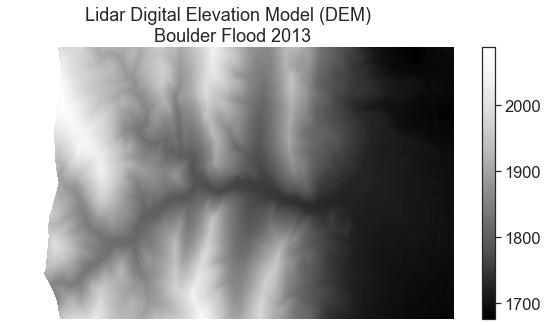

In [258]:
# Plot the data and notice that the scale bar looks better
# No data values are now masked
f, ax = plt.subplots(figsize=(10, 5))
dtm_pre_arr.plot(cmap="Greys_r",
                 ax=ax)
ax.set_title("Lidar Digital Elevation Model (DEM) \n Boulder Flood 2013")
ax.set_axis_off()
plt.show()

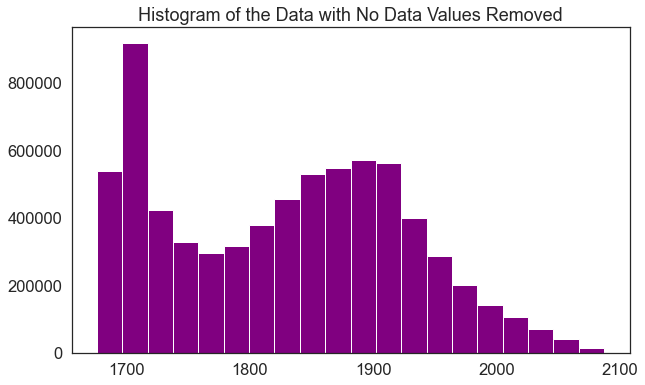

In [259]:
f, ax = plt.subplots(figsize=(10, 6))
dtm_pre_arr.plot.hist(color="purple",
                      bins=20)
ax.set_title("Histogram of the Data with No Data Values Removed")
plt.show()

Notice that now the minimum value looks more like an elevation value (which should most often not be negative).



In [260]:
print("The minimum raster value is: ", np.nanmin(dtm_pre_arr.data))
print("The maximum raster value is: ", np.nanmax(dtm_pre_arr.data))

The minimum raster value is:  1676.21
The maximum raster value is:  2087.43


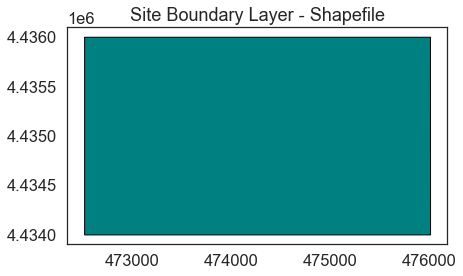

In [261]:
# Open site boundary vector layer
site_bound_path = os.path.join("colorado-flood",
                               "spatial",
                               "boulder-leehill-rd",
                               "clip-extent.shp")
site_bound_shp = gpd.read_file(site_bound_path)

# Plot the vector data
f, ax = plt.subplots(figsize=(8,4))
site_bound_shp.plot(color='teal',
                    edgecolor='black',
                    ax=ax)
ax.set(title="Site Boundary Layer - Shapefile")
plt.show()

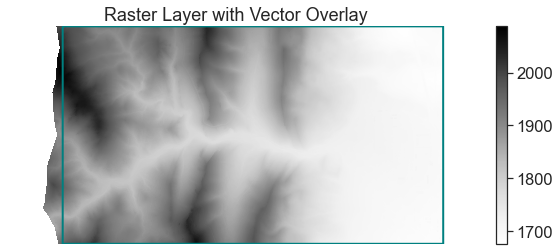

In [263]:
f, ax = plt.subplots(figsize=(11, 4))

dtm_pre_arr.plot.imshow(cmap="Greys",
                        ax=ax)
site_bound_shp.plot(color='None',
                    edgecolor='teal',
                    linewidth=2,
                    ax=ax,
                    zorder=4)

ax.set(title="Raster Layer with Vector Overlay")
ax.axis('off')
plt.show()